In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tensorflow.keras.models import load_model

In [2]:
# === Загружаем обученную модель ===
model = load_model('./models/BreastCancerSegmentor.h5')

In [3]:
def LoadDataForInference(imgPath, shape=256):
    data = {'img': [], 'img_names': []}
    imgNames = [f for f in os.listdir(imgPath) if f.endswith('.png')]

    for name in imgNames:
        img = plt.imread(os.path.join(imgPath, name))
        img = cv2.resize(img, (shape, shape))

        # Если изображение grayscale (2D), делаем его 3-канальным
        if len(img.shape) == 2:
            img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
        elif img.shape[2] == 1:
            img = np.concatenate([img]*3, axis=-1)

        data['img'].append(img)
        data['img_names'].append(name)

    return data


In [4]:
# === Функция предсказания и пост-обработки ===
def predict_and_plot(images, model, threshold=0.5, morph=True):
    imgs = np.array(images['img'])
    predictions = model.predict(imgs)

    for i in range(len(predictions)):
        img = imgs[i]
        pred = predictions[i][:,:,0]

        # === Бинаризация маски ===
        binary_mask = (pred > threshold).astype(np.uint8)

        # === Морфологическая очистка ===
        if morph:
            kernel = np.ones((3, 3), np.uint8)
            binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel)
            binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

        # === Отображение ===
        plt.figure(figsize=(10, 4))
        plt.suptitle(f'Image: {images["img_names"][i]}', fontsize=12)

        plt.subplot(1, 3, 1)
        plt.imshow(img)
        plt.title('Original Image')

        plt.subplot(1, 3, 2)
        plt.imshow(pred, cmap='gray')
        plt.title('Raw Prediction')

        plt.subplot(1, 3, 3)
        plt.imshow(binary_mask, cmap='gray')
        plt.title('Binary Mask')

        plt.tight_layout()
        plt.show()


14/14 ━━━━━━━━━━━━━━━━━━━━ 9s 613ms/step


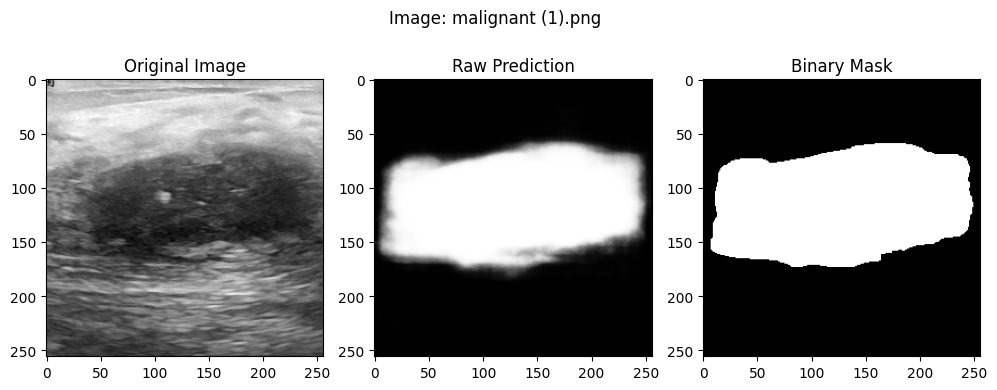

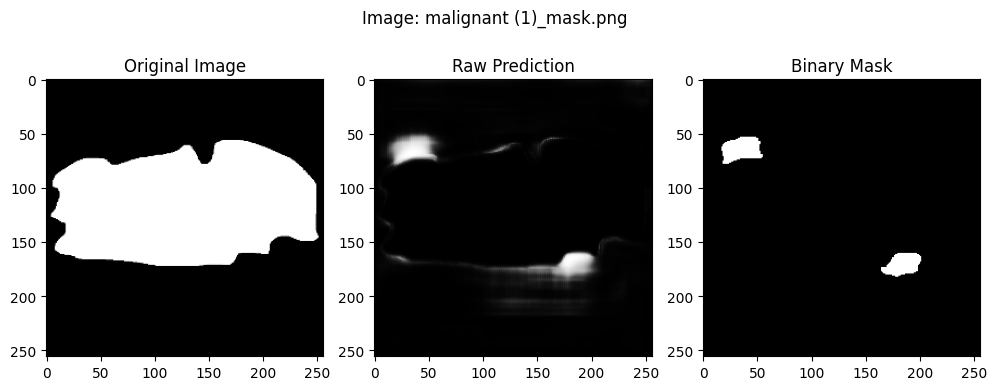

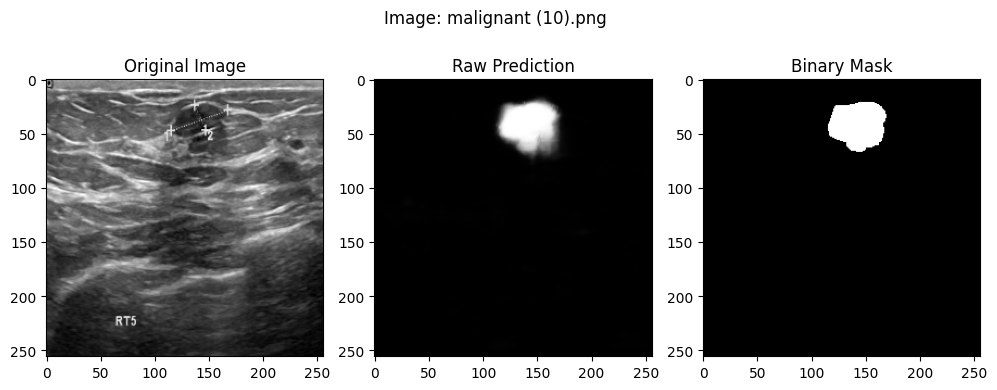

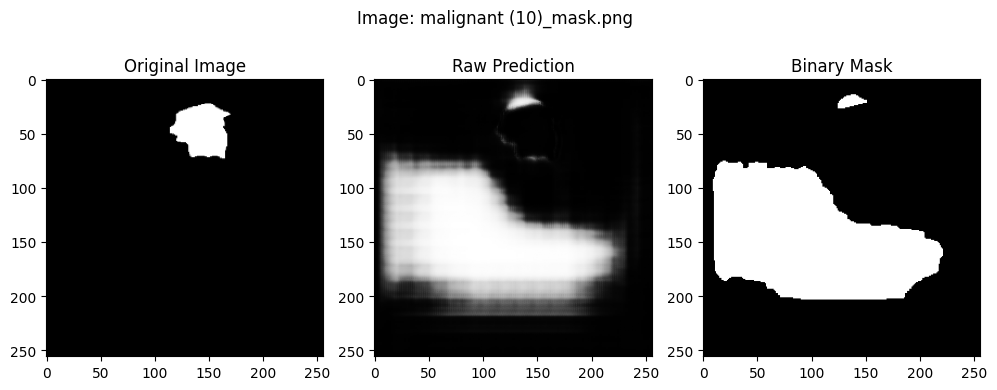

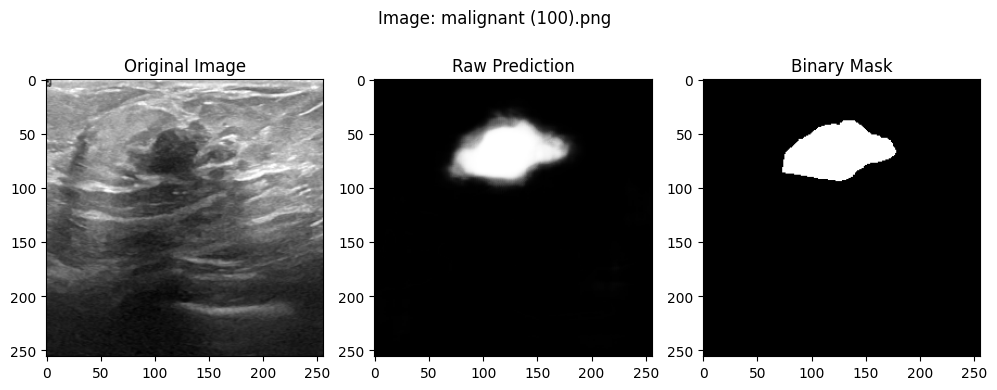

...

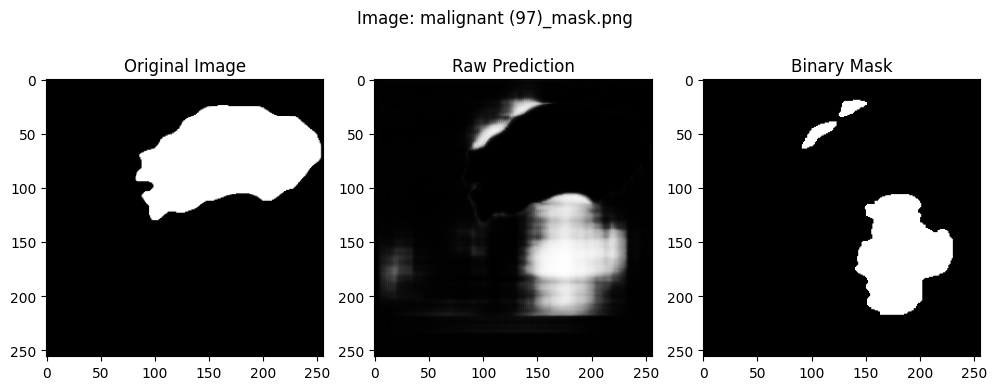

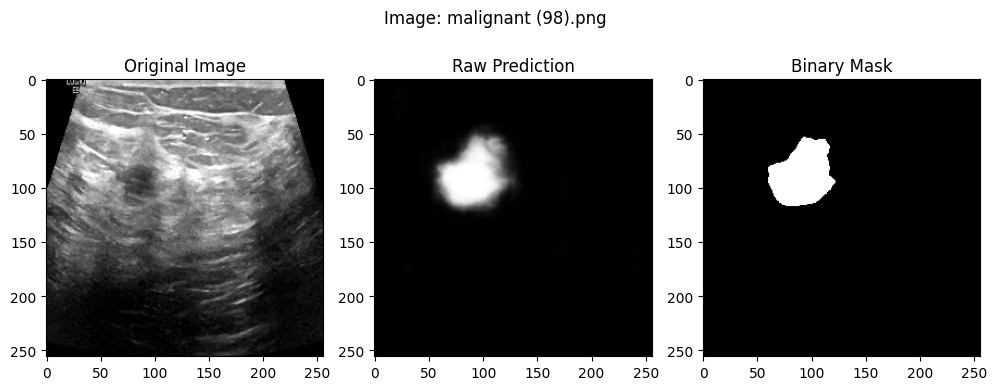

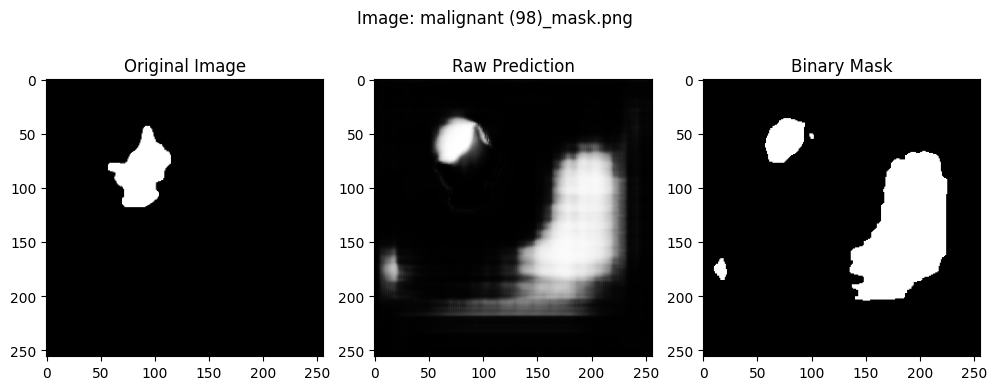

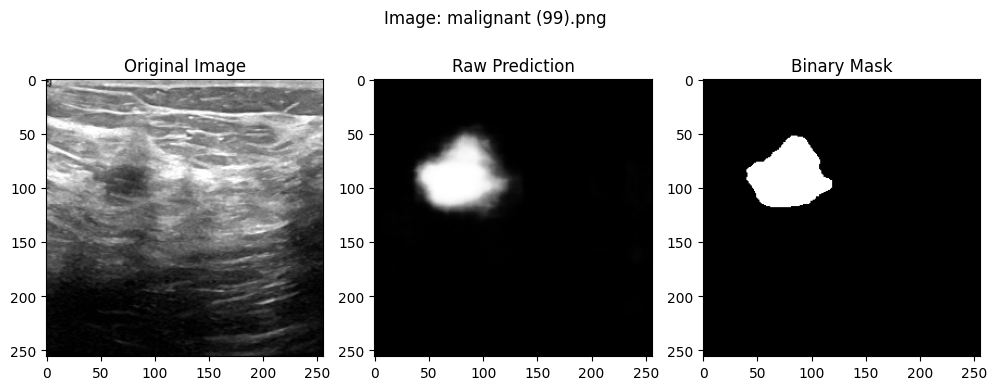

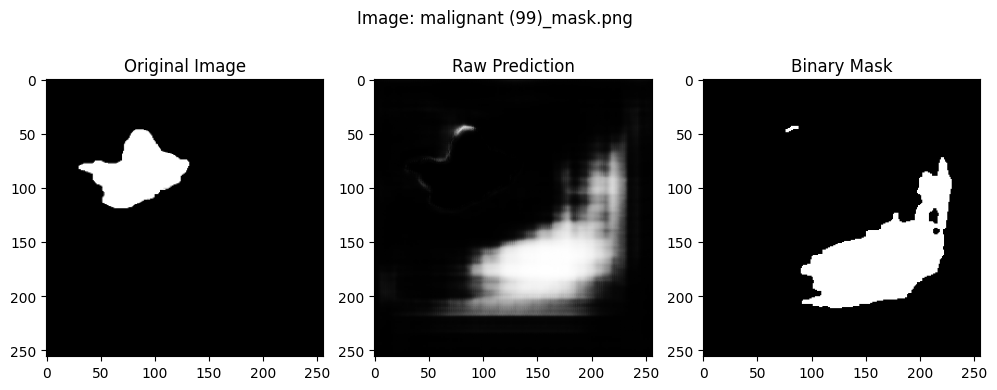

In [5]:
# === Путь к изображениям для инференса ===
inference_data_path = 'Dataset_BUSI_with_GT/malignant'  # или 'benign' / другой путь

# === Загружаем изображения ===
inference_imgs = LoadDataForInference(inference_data_path, shape=256)

# === Выполняем предсказание и отображаем результат ===
predict_and_plot(inference_imgs, model, threshold=0.5, morph=True)
